Animation size has reached 20986142 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


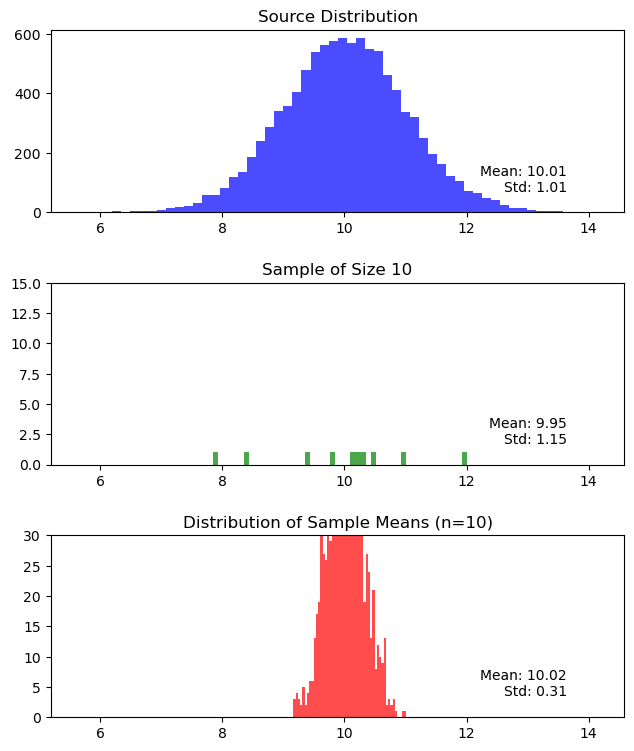

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set up the figure, the axis, and the plot elements
fig, axs = plt.subplots(3, 1, figsize=(7, 8))
fig.tight_layout(pad=3.0)
N = 10000  # size of the population
n = 10  # sample size
K = 1000  # number of times to sample

# Create the source distribution: Here I'm using a normal distribution for simplicity
mu = 10  # mean
sigma = 1  # standard deviation
source_data = np.random.normal(mu, sigma, N)

sample_means = []

def update(num):
    # Clear the previous histograms
    for ax in axs:
        ax.cla()
    
    x_min = min(source_data) - 1
    x_max = max(source_data) + 1
    # First panel: the population histogram
    axs[0].hist(source_data, bins=50, color='blue', alpha=0.7)
    axs[0].set_title("Source Distribution")
    axs[0].set_xlim(x_min, x_max)
    axs[0].text(x_max - 0.1 * (x_max - x_min), 0.8 * N/50, 
                'Mean: {:.2f}\nStd: {:.2f}'.format(np.mean(source_data), np.std(source_data)), 
                va="top", ha="right")


    # Second panel: sample histogram
    sample = np.random.choice(source_data, n)
    axs[1].hist(sample, bins=50, color='green', alpha=0.7)
    axs[1].set_title("Sample of Size {}".format(n))
    axs[1].set_xlim(x_min, x_max)
    axs[1].set_ylim(0, 15)
    axs[1].text(x_max - 0.1 * (x_max - x_min), 15 * 0.2666, 
                'Mean: {:.2f}\nStd: {:.2f}'.format(np.mean(sample), np.std(sample)), 
                va="top", ha="right")
    
    # Third panel: sample mean histogram
    # Add the mean of the current sample to sample_means
    sample_means.append(np.mean(sample))
    
    axs[2].hist(sample_means, bins=50, color='red', alpha=0.7)
    axs[2].set_title("Distribution of Sample Means (n={})".format(n))
    axs[2].set_xlim(x_min, x_max)
    axs[2].set_ylim(0, 30)
    axs[2].text(x_max - 0.1 * (x_max - x_min), 30 * 0.2666, 
                'Mean: {:.2f}\nStd: {:.2f}'.format(np.mean(sample_means), np.std(sample_means)), 
                va="top", ha="right")

    plt.draw()

ani = animation.FuncAnimation(fig, update, frames=K, repeat=False)
# Display the animation in the Jupyter Notebook
HTML(ani.to_jshtml())

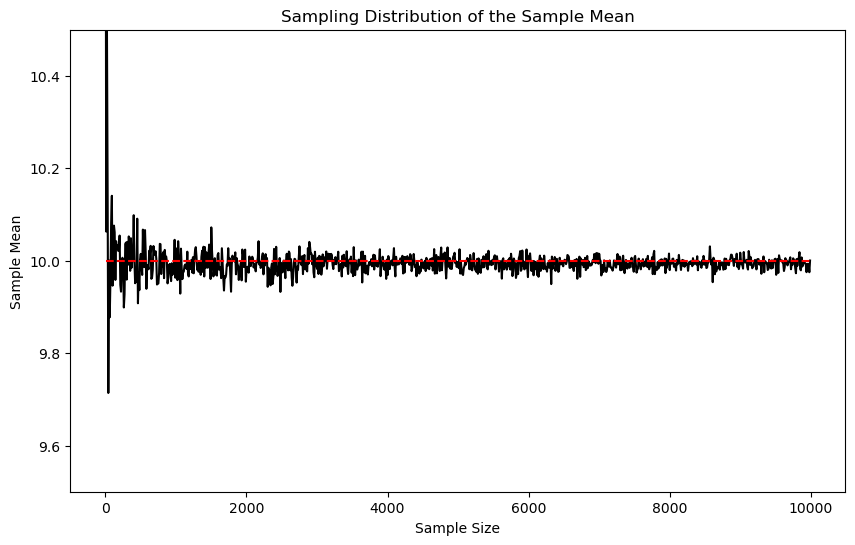

In [3]:
source_data = np.random.normal(mu, sigma, N)

# vector of sample sizes

n_vec = np.arange(1, 10000, 10)

# vector of sample means

sample_means = []

# simulate the sampling distribution of the sample mean for each sample size

for n in n_vec:
    sample = np.random.choice(source_data, n)
    sample_means.append(np.mean(sample))

# plot the sampling distribution of the sample mean for each sample size

plt.figure(figsize=(10, 6))
plt.plot(n_vec, sample_means, 'k-')
# real population mean
plt.plot(n_vec, [mu] * len(n_vec), 'r--')
# log transform the x-axis
# plt.xscale('log')
plt.ylim(9.5, 10.5)
plt.xlabel('Sample Size')
plt.ylabel('Sample Mean')
plt.title('Sampling Distribution of the Sample Mean')
plt.show()

In [4]:
import pandas as pd
import seaborn as sns
from collections import Counter

# media
def mean_fun(x):
    return sum(x) / len(x)

# mediana
def median_fun(x):
    x.sort()
    N = len(x)
    if N % 2 == 0:
        return (x[int(N / 2)] + x[int((N - 1) / 2)]) / 2
    else:
        return x[int((N - 1) / 2)]

# moda
def mode_fun(x):
    n = len(x)
    data = Counter(x)
    get_mode = dict(data)
    mode = [k for k, v in get_mode.items() if v == max(list(data.values()))]
    return mode[0]

# varianza
def var_fun(x):
    n = len(x)
    mean_x = sum(x) / n
    return sum([(i - mean_x) ** 2 for i in x]) / (n - 1)

# desviación estándar

def std_fun(x):
    var_x = var_fun(x)
    return var_x ** 0.5

# desviación absoluta media
def mad_fun(x):
    n = len(x)
    mean_x = sum(x) / n
    ab_dev = [abs(i - mean_x) for i in x]
    return (1/n) * sum(ab_dev)

# rango

def range_fun(x):
    x.sort() # ordena la lista de menor a mayor
    return x[-1] - x[0]

# center a variable

def center_fun(x):
    mean_x = sum(x) / len(x)
    return [i - mean_x for i in x]

# standardize a variable

def standardize_fun(x):
    std_x = std_fun(x)
    return [i / std_x for i in x]

# normalizar una variable

def normalize_fun(x):
    x_c = center_fun(x)
    std_x = std_fun(x)
    return [i / std_x for i in x_c]

In [5]:
x = [9, 10, 11, 11, 12, 14, 16, 17, 41, 61]

print("Media: ", mean_fun(x))
print("Mediana: ", median_fun(x))
print("Moda: ", mode_fun(x))
print("Varianza: ", var_fun(x))
print("Desviación estándar: ", std_fun(x))
print("Desviación absoluta media: ", mad_fun(x))
print("Rango: ", range_fun(x))
print("Centrar: ", center_fun(x))
print("Estandarizar: ", standardize_fun(x))
print("Normalizar: ", normalize_fun(x))

Media:  20.2
Mediana:  13.0
Moda:  11
Varianza:  292.17777777777775
Desviación estándar:  17.093208527885505
Desviación absoluta media:  12.32
Rango:  52
Centrar:  [-11.2, -10.2, -9.2, -9.2, -8.2, -6.199999999999999, -4.199999999999999, -3.1999999999999993, 20.8, 40.8]
Estandarizar:  [0.5265249052170391, 0.5850276724633768, 0.6435304397097145, 0.6435304397097145, 0.7020332069560521, 0.8190387414487275, 0.9360442759414028, 0.9945470431877406, 2.3986134570998447, 3.568668802026598]
Normalizar:  [-0.6552309931589819, -0.5967282259126443, -0.5382254586663066, -0.5382254586663066, -0.4797226914199689, -0.36271715692729356, -0.24571162243461822, -0.18720885518828054, 1.2168575587238237, 2.386912903650577]


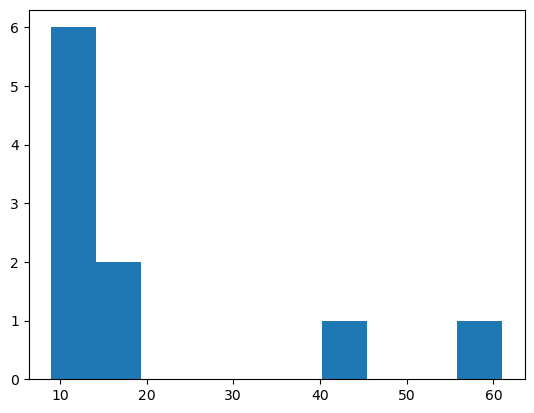

In [6]:
plt.hist(x, bins=10)
plt.show()

(array([6., 2., 0., 0., 0., 0., 1., 0., 0., 1.]),
 array([-0.65523099, -0.3510166 , -0.04680221,  0.25741218,  0.56162657,
         0.86584096,  1.17005534,  1.47426973,  1.77848412,  2.08269851,
         2.3869129 ]),
 <BarContainer object of 10 artists>)

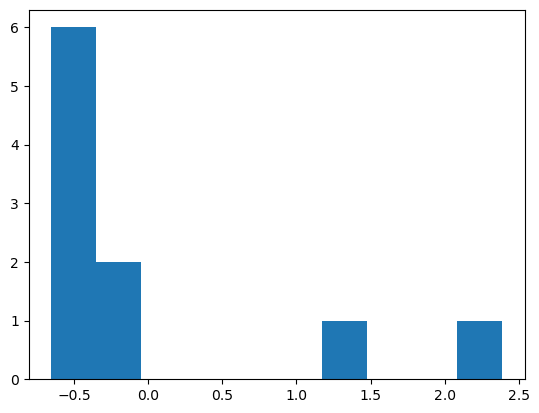

In [7]:
plt.hist(normalize_fun(x), bins=10)

/home/mrrobot/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

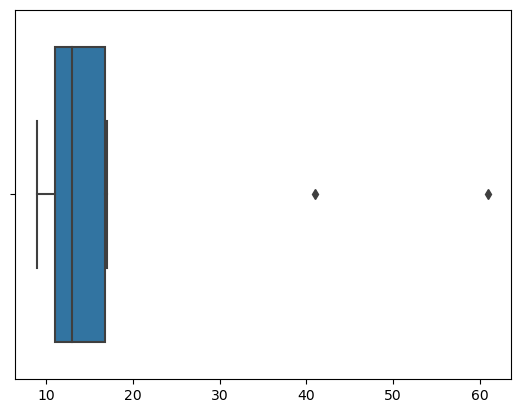

In [8]:
sns.boxplot(x)

<AxesSubplot:ylabel='Count'>

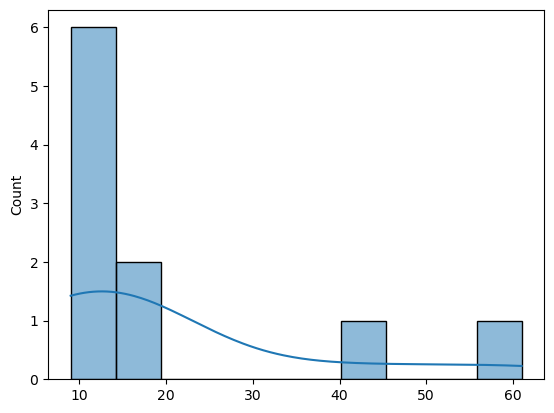

In [9]:
sns.histplot(x, bins=10, kde=True)

In [10]:

# Cargamos el conjunto de datos
iris = sns.load_dataset('iris')

# Seleccionamos una columna para hacer los cálculos
column = iris['sepal_length'].tolist()

print("Media:", mean_fun(column))
print("Mediana:", median_fun(column))
print("Moda:", mode_fun(column))
print("Desviación media absoluta:", mad_fun(column))

Media: 5.843333333333335
Mediana: 5.8
Moda: 5.0
Desviación media absoluta: 0.6875555555555557


In [11]:
import pandas as pd

iris.describe()

,sepal_length,sepal_width,petal_length,petal_width
count,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.057333,3.758000,1.199333
std,0.828066,0.435866,1.765298,0.762238
min,4.300000,2.000000,1.000000,0.100000
25%,5.100000,2.800000,1.600000,0.300000
50%,5.800000,3.000000,4.350000,1.300000
75%,6.400000,3.300000,5.100000,1.800000
max,7.900000,4.400000,6.900000,2.500000


<AxesSubplot:ylabel='Count'>

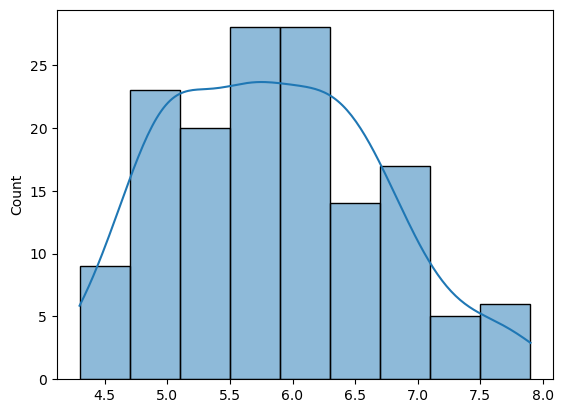

In [12]:
sns.histplot(column, kde=True)